In [10]:
import os
import pickle
from glob import glob
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import cv2
import math
from skimage import feature

In [11]:
# Função para mostrar várias imagens em forma de uma grade
def image_grid(images, cols = 4):
    n_images = len(images)
    fig = plt.figure()
    for n, (image) in enumerate(images):
        a = fig.add_subplot(int(cols), int(np.ceil(n_images/float(cols))), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

In [12]:
# https://github.com/sunnyshah2894/DigitalHairRemoval

def remove_hairs(img):
    kernel = cv2.getStructuringElement(1,(17,17))
    grayScale = cv2.cvtColor( img, cv2.COLOR_RGB2GRAY )
    edges = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
    ret,thresh = cv2.threshold(edges,10,255,cv2.THRESH_BINARY)
    dst = cv2.inpaint(img,thresh,1,cv2.INPAINT_TELEA)
    
    return edges, thresh, dst

In [13]:
# Função para aplicar um equalizador de histograma adaptativo (CLAHE)
def adaptive_histeq(img_gray):
      clahe = cv2.createCLAHE(clipLimit = 2.0, tileGridSize=(8,8))
      final_img = clahe.apply(img_gray) 
      return final_img

In [14]:
def lesion_segmentation1(img):
    
    #img = remove_hairs(img)
    
    R, G, B = cv2.split(img)
    norm_img = np.zeros((800,800))
    r_norm = cv2.normalize(R,  norm_img, 0, 255, cv2.NORM_MINMAX)

    blur = cv2.GaussianBlur(r_norm,(13,13),0)
    imgeq=adaptive_histeq(blur)
    
    T,imgt = cv2.threshold(imgeq,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)

    final_img = cv2.bitwise_not(imgt)
    
    kernel = np.ones((7,7),np.uint8)
    closing = cv2.morphologyEx(final_img, cv2.MORPH_CLOSE, kernel)
    
    
    return closing

In [15]:
def simple_score(lesion, mask):
    if mask.shape != lesion.shape:
        raise Exception(f"Image dimensions do not match. Image1: {mask.shape} x Image2: {lesion.shape}")
    TP=0
    FP=0
    TN=0
    FN = 0
    linhas,colunas=mask.shape
    for l in range(linhas):
      for c in range(colunas):
        if mask[l][c] == lesion[l][c] and mask[l][c]==255:
            TP+=1
        elif mask[l][c] == lesion[l][c] and mask[l][c]==0:
            TN+=1
        elif mask[l][c]==255:
            FP+=1
        else:
            FN+=1
            
    return TP,TN, FP, FN

In [16]:
def pixel_accuracy(TP,TN,FP,FN):
    '''measures how well a binary segmentation
    method correctly identifies or excludes a condition'''
    
    return (TP+TN)/(TP+TN+FP+FN)

In [17]:
def jaccards_index(TP,TN,FP,FN):
    return TP/(TP+FP+FN)

In [18]:
def dice_coefficient(TP,TN,FP,FN):
    return 2*TP/(2*TP+FP+FN)

In [19]:
def sensitivity(TP,TN,FP,FN):
    '''proportion of real positives that are correctly identified'''
    return TP/(TP+FN)

In [20]:
def specificity(TP,TN,FP,FN):
    '''proportion of real negatives that are correctly identified'''
    return TN/(TN+FP)

In [21]:
def compare_images(masks_path, lesions_path, segmentation_func):
    results_list = []

    for f in os.listdir(lesions_path):
            if f.endswith(".jpg"):
                try:
                    lesion = lesions_path+f
                    lesion_img = cv2.imread(lesion)[:,:,::-1]
                    mask = masks_path+f[:-4]+"_segmentation"+".png"
                    mask_img = cv2.imread(mask, cv2.IMREAD_UNCHANGED)

                    segmented_lesion = segmentation_func(lesion_img)
                                        
                    TP, TN, FP, FN = simple_score(segmented_lesion,mask_img)
                    
                    score = ( pixel_accuracy(TP,TN,FP,FN), jaccards_index(TP,TN,FP,FN), dice_coefficient(TP,TN,FP,FN), sensitivity(TP,TN,FP,FN),  specificity(TP,TN,FP,FN))
                    
                    print(score)

                    results_list.append( (score, segmented_lesion, mask_img) )
                     
                except AttributeError:
                    #print("Lesion image has no corresponding mask")
                    pass
    return results_list

In [22]:
LESIONS_PATH = '../../../ISIC/Lesions/'
MASKS_PATH = '../../../ISIC/Masks/'

In [23]:
results = compare_images(MASKS_PATH, LESIONS_PATH,  lesion_segmentation1)

(0.5798381195759266, 0.029392815203113744, 0.05710709219845123, 0.02963408668521042, 0.9938237298438217)
(0.6540738031914893, 0.014132666958797684, 0.02787143619222724, 0.016113699534299877, 0.9376844417487035)
(0.7143160502115885, 0.1448206822524532, 0.2530015128090037, 0.16053180088267807, 0.953202069068446)
(0.9347139994303385, 0.5873014597132017, 0.7399998987203313, 0.9985786330276483, 0.9281625431292525)
(0.7538032531738281, 0.2691022751724216, 0.4240828819503315, 0.4068649833340943, 0.8532534717223146)
(0.7747027079264323, 0.27510504330607183, 0.4315017727367526, 0.29797265858684335, 0.9665493868219778)
(0.40593719482421875, 0.3387672954550601, 0.5060883943089001, 0.8681588520980911, 0.15641954931088697)
(0.9422480265299479, 0.7732252169484417, 0.8721116861614359, 0.9935967354899973, 0.9295562455794245)
(0.9474323510522215, 0.8009378182880416, 0.8894674876108796, 0.9203693717786283, 0.9555073676708856)
(0.9144105132774746, 0.5013896554771236, 0.6679007726582317, 0.575410243760503

In [25]:
scores_px = [r[0][0] for r in results]
scores_jaccard = [r[0][1] for r in results]
scores_dice = [r[0][2] for r in results]
scores_sensitivity = [r[0][3] for r in results]
scores_specificity = [r[0][4] for r in results]

processed = [r[1] for r in results]
answers = [r[2] for r in results]

In [26]:
pixel_accuracy_score = sum(scores_px)/len(scores_px)
dice_coefficient_score = sum(scores_jaccard)/len(scores_jaccard)
jaccards_index_score = sum(scores_dice)/len(scores_dice)
sensitivity_score = sum(scores_sensitivity)/len(scores_sensitivity)
specificity_score = sum(scores_specificity)/len(scores_specificity)

print("Score pixel accuracy: ", pixel_accuracy_score)
print("Score jaccards index: ", jaccards_index_score)
print("Score dice coefficient: ", dice_coefficient_score)
print("Sensitivity: ", sensitivity_score)
print("Specificity: ", specificity_score)

Score pixel accuracy:  0.7198353649584267
Score jaccards index:  0.4581088824637623
Score dice coefficient:  0.33244900399683563
Sensitivity:  0.48706025833337874
Specificity:  0.8087008702911777


# Image segmentation results

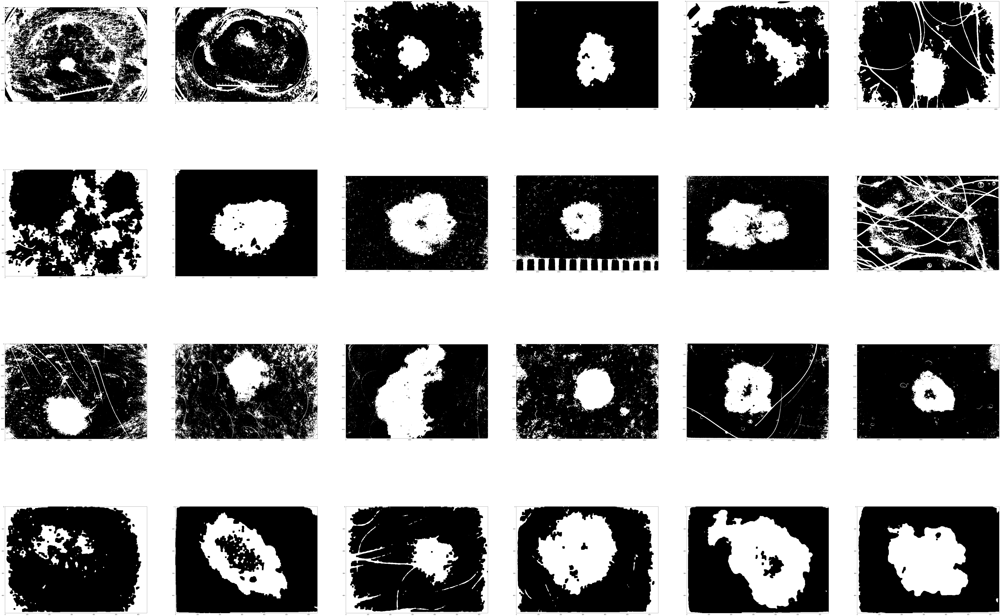

In [18]:
image_grid(processed[:24], cols = 4)

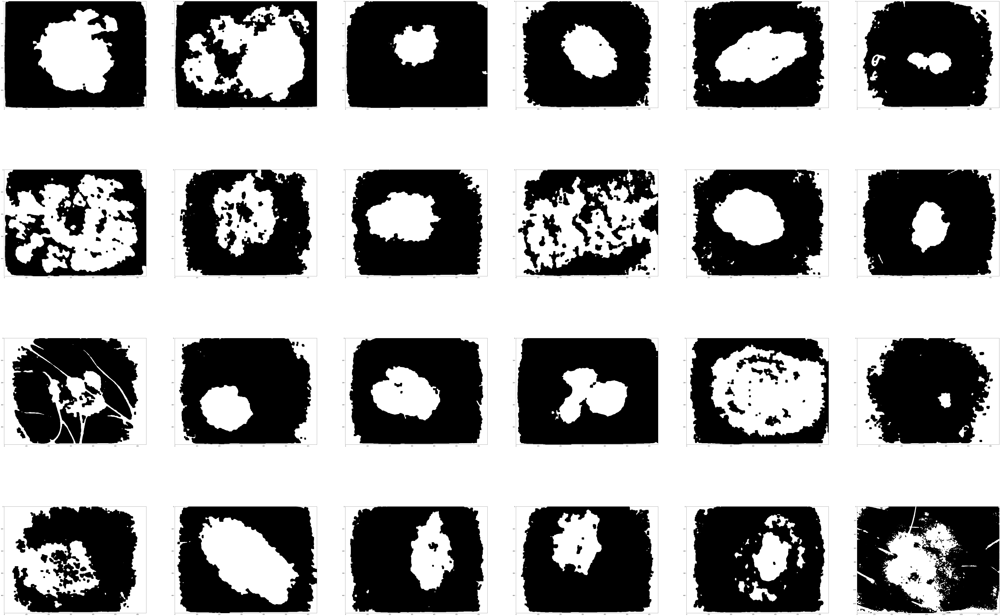

In [19]:
image_grid(processed[24:48], cols = 4)

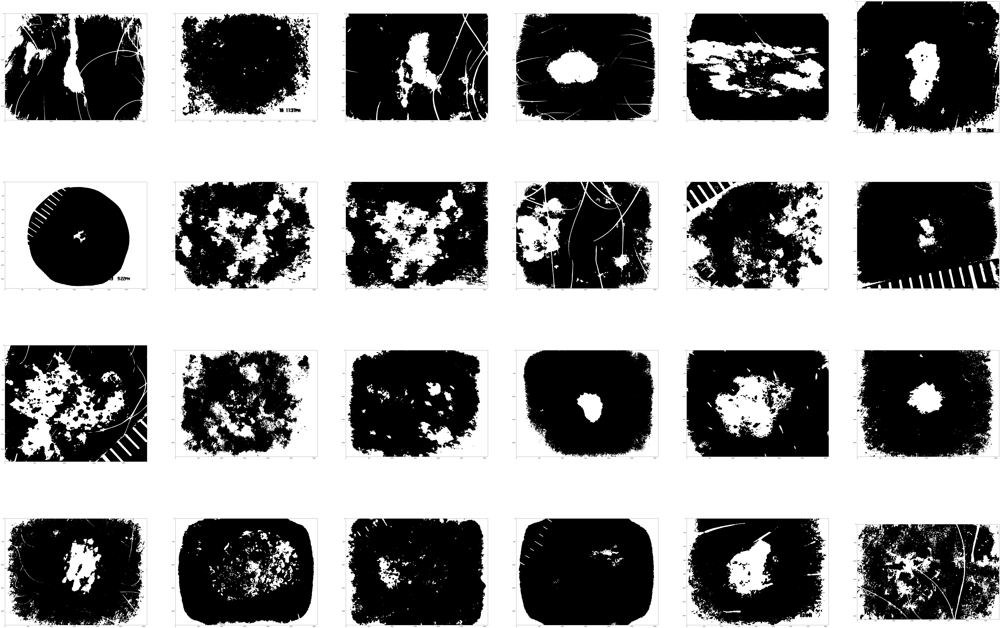

In [20]:
image_grid(processed[48:72], cols = 4)

In [21]:
image_grid(processed[72:], cols = 4)

# Segmentation differences

In [22]:
difference = []
for i in range(len(processed)):
    difference.append(cv2.bitwise_xor(processed[i], answers[i]))

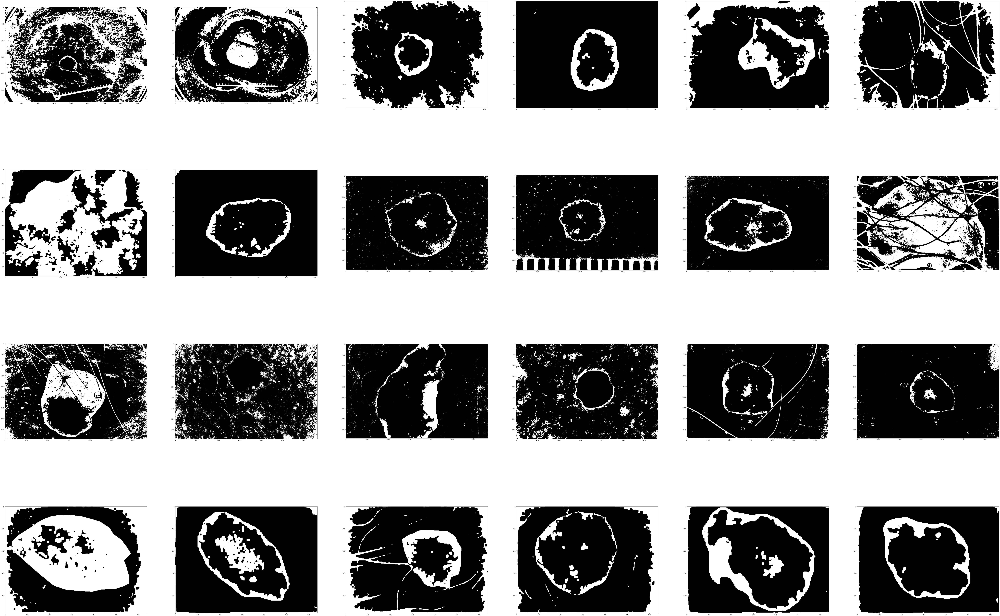

In [23]:
image_grid(difference[:24], cols = 4)

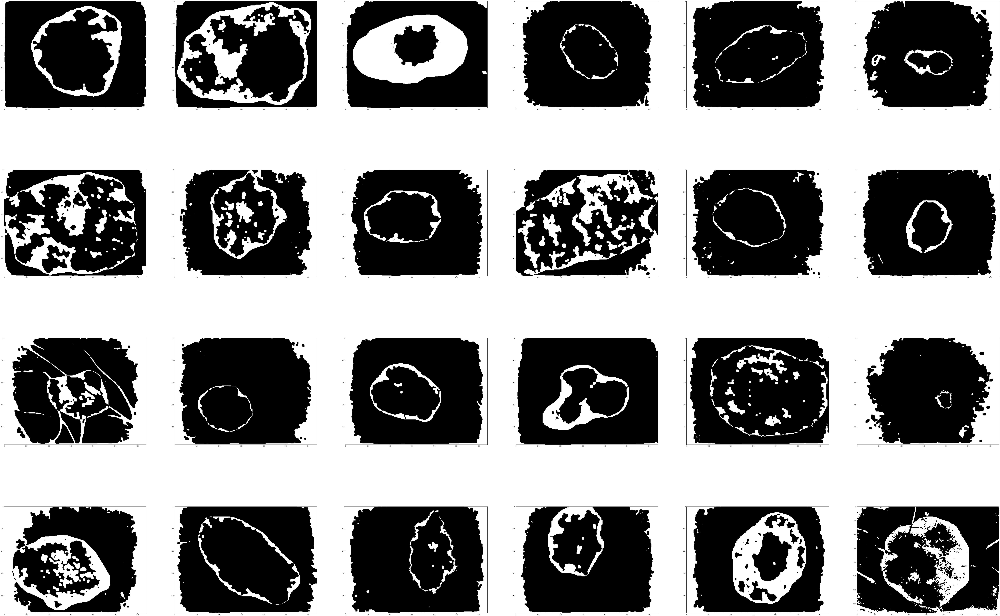

In [24]:
image_grid(difference[24:48], cols = 4)

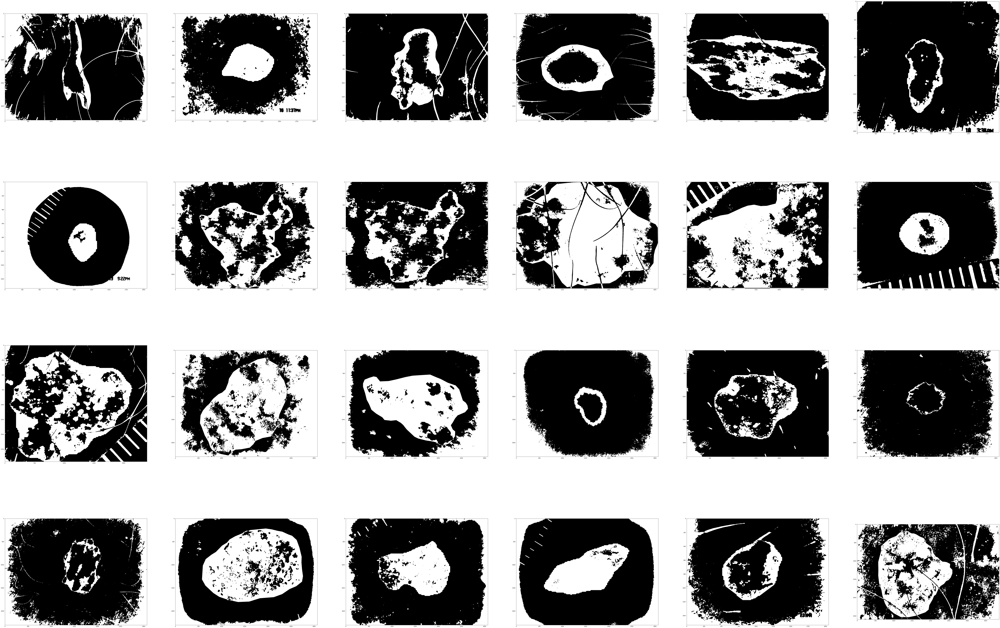

In [25]:
image_grid(difference[48:72], cols = 4)

In [26]:
image_grid(difference[72:], cols = 4)

## References
https://www.jeremyjordan.me/evaluating-image-segmentation-models/


https://towardsdatascience.com/how-accurate-is-image-segmentation-dd448f896388

In [56]:
def preprocessing_color(img):
        
    R, G, B = cv2.split(img)
    norm_img = np.zeros((800,800))
    r_norm = cv2.normalize(R,  norm_img, 0, 255, cv2.NORM_MINMAX)

    blur = cv2.GaussianBlur(r_norm,(13,13),0)
    
    imgeq=cv2.equalizeHist(blur)

    return imgeq

In [72]:
def color_test(masks_path, lesions_path, segmentation_func):
    results_list = []

    i=0
    for f in os.listdir(lesions_path):
            if f.endswith(".jpg"):
#                 #print(f)
#                 try:
                    lesion = lesions_path+f
                    lesion_img = cv2.imread(lesion)[:,:,::-1]
                    mask = masks_path+f[:-4]+"_segmentation"+".png"
                    mask_img = cv2.imread(mask, cv2.IMREAD_UNCHANGED)
#                     print(lesion_img.shape)

                    segmented_lesion = segmentation_func(lesion_img)
                    
#                     gray = cv2.cvtColor(lesion_img, cv2.COLOR_BGR2GRAY )
                    
                    l_lines, l_cols = segmented_lesion.shape
                    tol=50
                    vals = []
                    for l in range (int(l_lines/2)-tol, int(l_lines/2)+tol):
                        for c in range (int(l_cols/2)-tol, int(l_cols/2)+tol):
                            vals.append(segmented_lesion[l][c])
                    

                                        
                    results_list.append((segmented_lesion, vals))
                    if i>4:
                        return results_list
                    i+=1
#                   
#                 except AttributeError:
#                     #print("Lesion image has no corresponding mask")
#                     pass
    return results_list

In [74]:
color_results = color_test(MASKS_PATH, LESIONS_PATH,  preprocessing_color)

In [79]:
color_imgs = [r[0] for r in color_results]
color_vals = [r[1] for r in color_results]

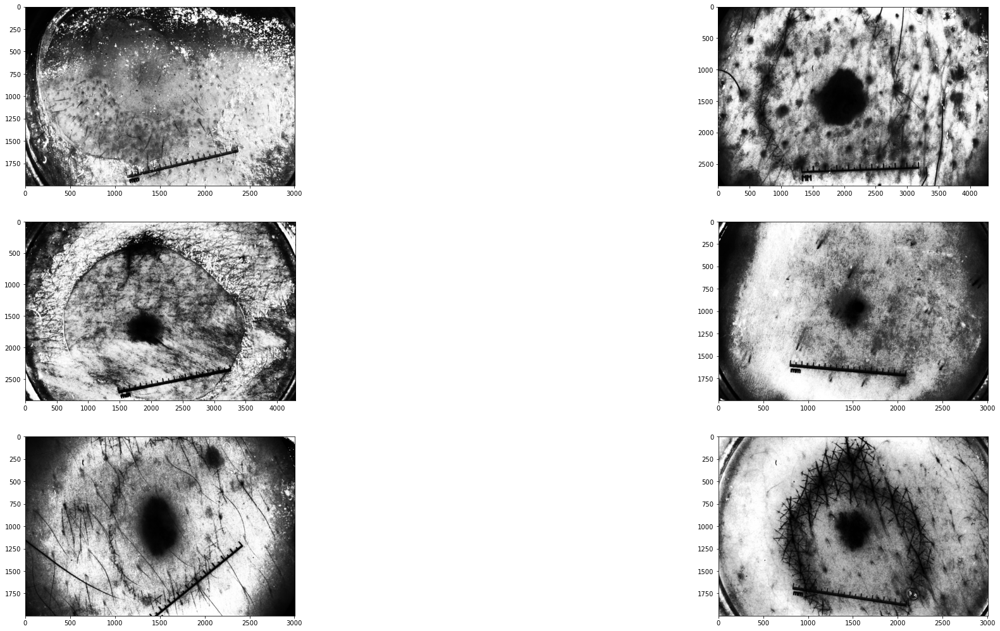

In [76]:
image_grid(color_imgs)

In [102]:
def thresh_segmentation(img, thresh):
    T,imgt = cv2.threshold(img,thresh,255,cv2.THRESH_BINARY)
    return imgt

In [108]:
processed_color_imgs=[]
for r in range(len(color_vals)):
    processed_color_imgs.append(thresh_segmentation(color_imgs[r],np.max(color_vals[r])))

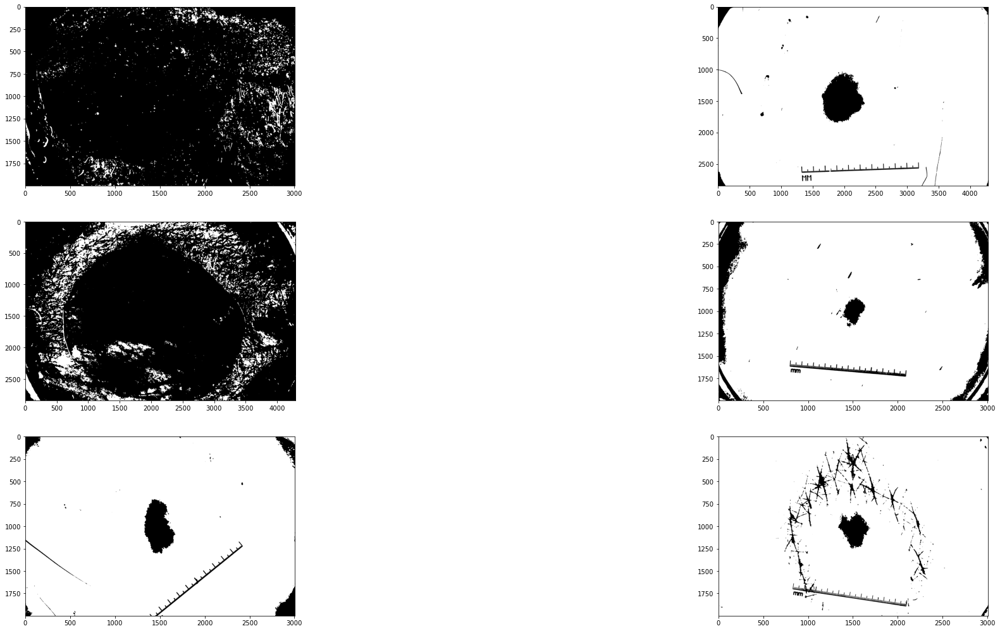

In [109]:
image_grid(processed_color_imgs)